# ControlNet with Stable Diffusion for Image Generation

This notebook demonstrates how to use a pretrained ControlNet model with Stable Diffusion to generate an image from a sketch and a text prompt.

### 1. Install Dependencies

First, we need to install the necessary libraries from Hugging Face, along with OpenCV for image processing and xformers for memory optimization.

In [22]:
# !pip install -q diffusers transformers accelerate opencv-python controlnet-aux xformers
!pip install -q --force-reinstall torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
!pip install -q -U xformers
!pip install -q -U diffusers transformers accelerate opencv-python controlnet-aux

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.2/23.2 MB 46.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 875.6/875.6 kB 30.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 53.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 663.9/663.9 MB ? eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 417.9/417.9 MB ? eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.4/168.4 MB 535.9 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.1/58.1 MB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.2/128.2 MB 490.1 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.1/204.1 MB 356.9 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.8/147.8 MB 454.0 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.9/60.9 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

### 2. Import Libraries

Import all the required modules for image processing, model loading, and generation.

In [1]:
import torch
import cv2
import numpy as np
from PIL import Image
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, UniPCMultistepScheduler
from controlnet_aux import CannyDetector
from IPython.display import display

/usr/local/lib/python3.11/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/usr/local/lib/python3.11/dist-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/usr/local/lib/python3.11/dist-packages/controlnet_aux/segment_anything/modeling/tiny_vit_sam.py:654: UserWarning: Overwriting tiny_vit_5m_224 in registry with controlnet_aux.segmen

### 3. Configuration: Set Execution Device

Set `USE_GPU` to `True` to run on a CUDA-enabled GPU or `False` to run on the CPU. Running on a CPU will be significantly slower.

In [2]:
USE_GPU = True # Set to True for GPU, False for CPU

### 4. Load and Preprocess the Sketch Image

We will load the sketch from `static/assets/sketch.png` and use a Canny edge detector to process it. This will create an edge map that the ControlNet model can use as a condition.

Original Sketch:


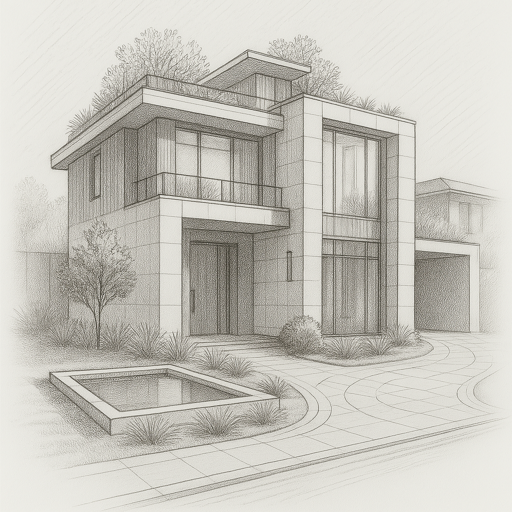

Processed Canny Edge Map:


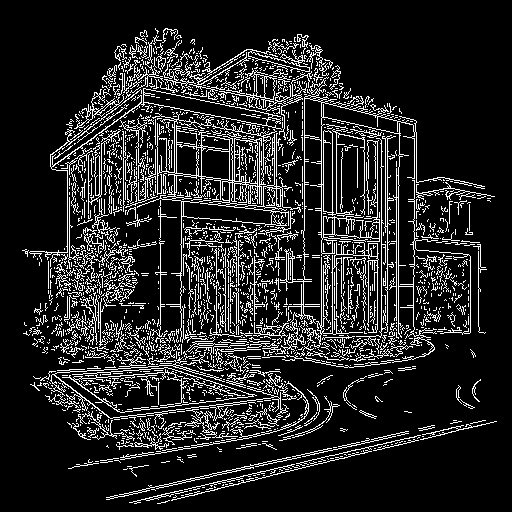

In [3]:
image_path = '/content/sketch.png'
input_image = Image.open(image_path).convert("RGB")

# Canny edge detection
canny_detector = CannyDetector()
control_image = canny_detector(input_image, low_threshold=100, high_threshold=200)

print("Original Sketch:")
display(input_image.resize((512, 512)))

print("Processed Canny Edge Map:")
display(control_image.resize((512, 512)))

### 5. Load Pretrained Models

We'll load a pretrained ControlNet model and a Stable Diffusion base model. The configuration will adapt based on whether a GPU is used.

In [4]:
device = "cuda" if USE_GPU and torch.cuda.is_available() else "cpu"
torch_dtype = torch.float16 if USE_GPU and torch.cuda.is_available() else torch.float32

print(f"Using device: {device}")
print(f"Using torch dtype: {torch_dtype}")

# Load ControlNet model
controlnet = ControlNetModel.from_pretrained(
    # "lllyasviel/sd-controlnet-canny",
    'ControlNet-1-1-preview/control_v11p_sd15_lineart',
    torch_dtype=torch_dtype
)

# Load Stable Diffusion model pipeline
pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    controlnet=controlnet,
    torch_dtype=torch_dtype
)

# Configure the scheduler
pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

# Move to device and apply optimizations if using GPU
if device == "cuda":
    pipe.to(device)
    pipe.enable_model_cpu_offload()
    pipe.enable_vae_slicing()
    try:
        pipe.enable_xformers_memory_efficient_attention()
        print("Memory-efficient attention enabled.")
    except ImportError:
        print("xformers not installed. For faster inference, install it with 'pip install xformers'.")
else:
    pipe.to(device)

print("Models loaded and pipeline is ready.")

Using device: cuda
Using torch dtype: torch.float16


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Memory-efficient attention enabled.
Models loaded and pipeline is ready.


### 6. Generate the Image

Now, we'll define a detailed prompt and run the pipeline to generate the final image. The prompt should describe the desired output in detail, and the ControlNet will ensure the generated image follows the structure of the input sketch.

Token indices sequence length is longer than the specified maximum sequence length for this model (122 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['yard with a walkway of large , square light - grey concrete pavers . the lighting is soft and even , as if on a bright , slightly overcast day . the overall mood is serene , clean , and high - end .']


  0%|          | 0/20 [00:00<?, ?it/s]

Generated Image:


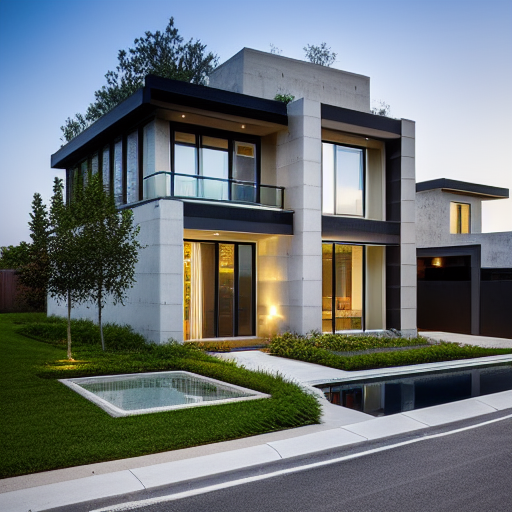

In [5]:
prompt = "A photorealistic, high-resolution architectural photograph of a modern, two-story minimalist house. The architecture is cubist and blocky, constructed from large, smooth, off-white precast concrete panels. The main roof is a green roof with lush vegetation. The window frames are thin and dark charcoal metal. The house is set in a professionally landscaped front yard with a walkway of large, square light-grey concrete pavers. The lighting is soft and even, as if on a bright, slightly overcast day. The overall mood is serene, clean, and high-end."
negative_prompt = "low quality, bad quality, sketches, cartoon, drawing, anime, ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, blurry, bad anatomy, blurred, watermark, grainy, signature, cut off, draft"

generator = torch.manual_seed(42) # for reproducibility

generated_image = pipe(
    prompt,
    num_inference_steps=20, # Reduced steps for faster CPU inference
    generator=generator,
    image=control_image,
    negative_prompt=negative_prompt,
    controlnet_conditioning_scale=0.5
).images[0]

print("Generated Image:")

display(generated_image)

## Swith to Lineart Detector

Original Sketch:


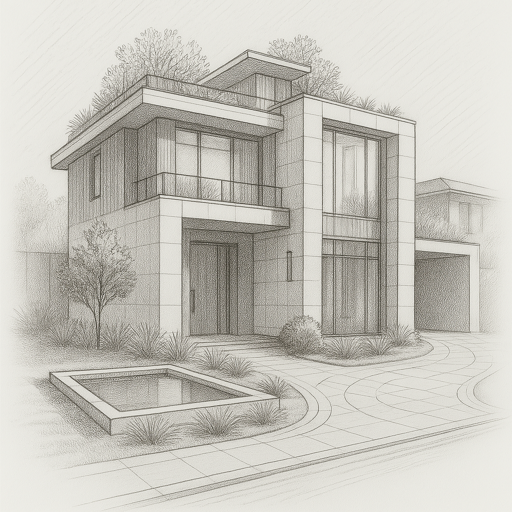

Processed Lineart Map:


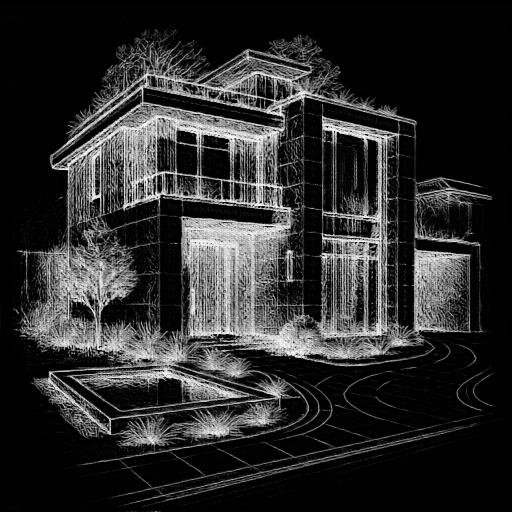

In [6]:
from controlnet_aux import LineartDetector

image_path = '/content/sketch.png'
input_image = Image.open(image_path).convert("RGB")

# Lineart detection
lineart_detector = LineartDetector.from_pretrained("lllyasviel/Annotators")
control_image = lineart_detector(input_image)

print("Original Sketch:")
display(input_image.resize((512, 512)))

print("Processed Lineart Map:")
display(control_image.resize((512, 512)))

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with

  0%|          | 0/20 [00:00<?, ?it/s]

Generated Image:


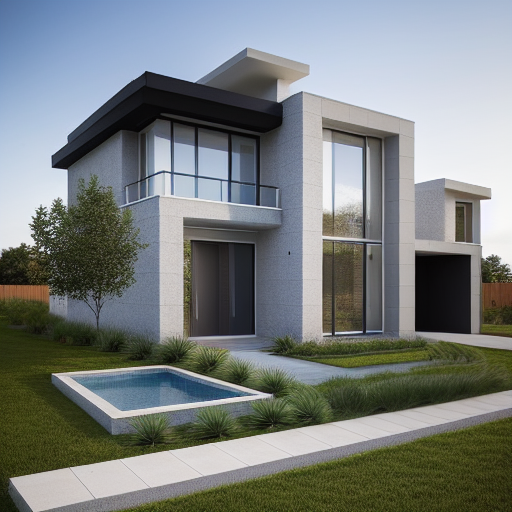

In [7]:
prompt = """A photorealistic, high-resolution architectural photograph of a modern, two-story minimalist house, captured from an eye-level, three-quarters perspective, from left.

The architecture is cubist and blocky, constructed from large, smooth, off-white or light grey precast concrete panels. The structure features a tiered flat roof system. The main roof is a green roof, covered in lush sedum, ornamental grasses, and small manicured bushes.

Window and door details must be exact:

The window frames are thin and made of dark charcoal metal.

On the right side of the facade, there is a two-story section of floor-to-ceiling glass windows.

On the second floor's front facade, a large horizontal window provides access to a balcony.

On the left side of the second floor, there is one smaller, vertical window.

The front door is tall, modern, and made of a dark wood with a vertical handle.

The second-floor balcony is enclosed by a simple, thin black metal railing.

The house is set in a professionally landscaped front yard with modern, sparse plantings. A walkway composed of large, square light-grey concrete pavers curves gently toward the entrance. In the foreground, there is a shallow, square reflecting pool with a minimalist concrete border. The landscaping includes clumps of ornamental grass and a single, small, elegant tree. To the right of the main structure is an integrated, open-air carport.

The lighting should be soft and even, as if captured on a bright, slightly overcast day to eliminate harsh shadows and perfectly highlight the building's clean lines and material textures. The overall mood is serene, clean, and high-end."""

negative_prompt = "low quality, bad quality, sketches, cartoon, drawing, anime, ugly, tiling, blurry, blurred, watermark, grainy, signature, cut off, draft, unrealistic"

generator = torch.manual_seed(42) # for reproducibility

generated_image = pipe(
    prompt,
    num_inference_steps=20, # Reduced steps for faster CPU inference
    generator=generator,
    image=control_image,
    negative_prompt=negative_prompt,
    controlnet_conditioning_scale=0.5
).images[0]

print("Generated Image:")
display(generated_image)

In [8]:
generated_image = pipe(
    prompt,
    num_inference_steps=50, # Reduced steps for faster CPU inference
    generator=generator,
    image=control_image,
    negative_prompt=negative_prompt,
    controlnet_conditioning_scale=0.5
).images[0]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with

  0%|          | 0/50 [00:00<?, ?it/s]

Generated Image:


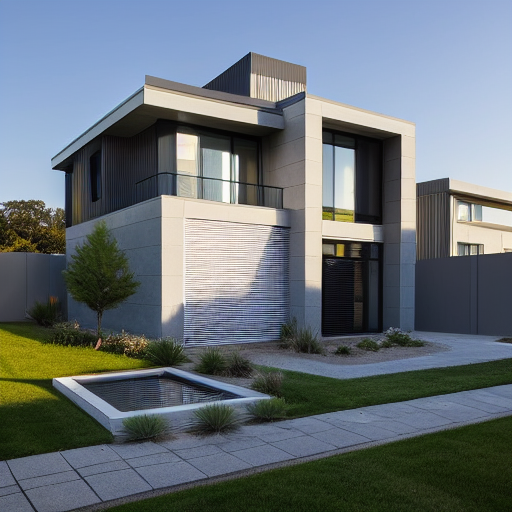

In [9]:

print("Generated Image:")
display(generated_image)

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with

  0%|          | 0/50 [00:00<?, ?it/s]

Generated Image:


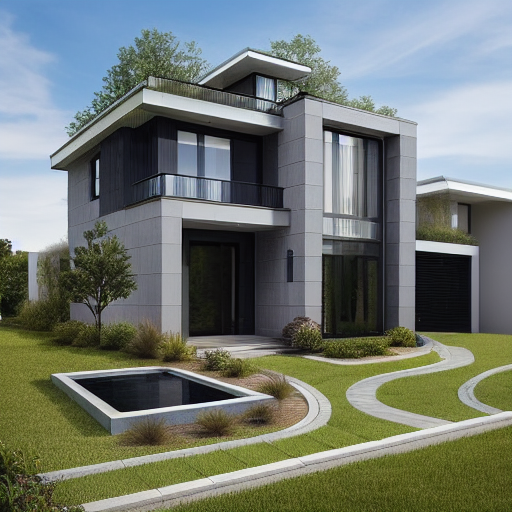

In [11]:
generated_image = pipe(
    prompt,
    num_inference_steps=50, # Reduced steps for faster CPU inference
    generator=generator,
    image=control_image,
    negative_prompt=negative_prompt,
    controlnet_conditioning_scale=1.0,
).images[0]

print("Generated Image:")
display(generated_image)

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with

  0%|          | 0/50 [00:00<?, ?it/s]

Generated Image:


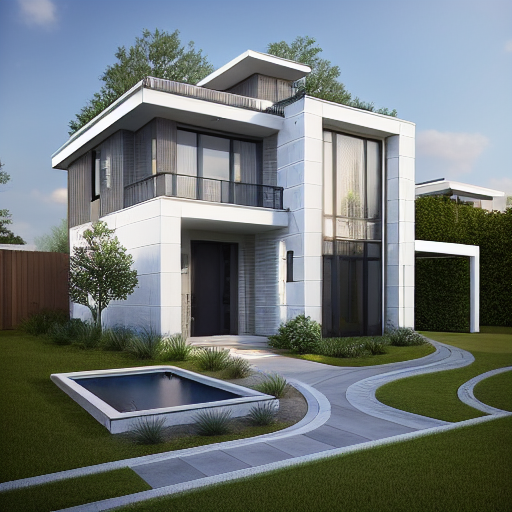

In [12]:
generated_image = pipe(
    prompt,
    num_inference_steps=50, # Reduced steps for faster CPU inference
    generator=generator,
    image=control_image,
    negative_prompt=negative_prompt,
    controlnet_conditioning_scale=1.0,
    guidance_scale=10
).images[0]

print("Generated Image:")
display(generated_image)

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=5, controlnet_conditioning_scale=0.5


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 5, controlnet_scale: 0.5


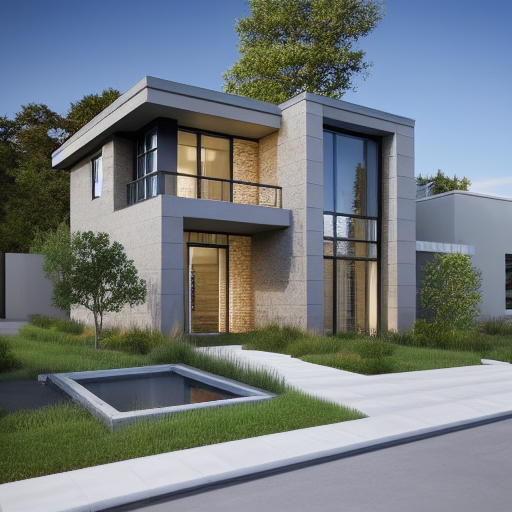

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=5, controlnet_conditioning_scale=0.75


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 5, controlnet_scale: 0.75


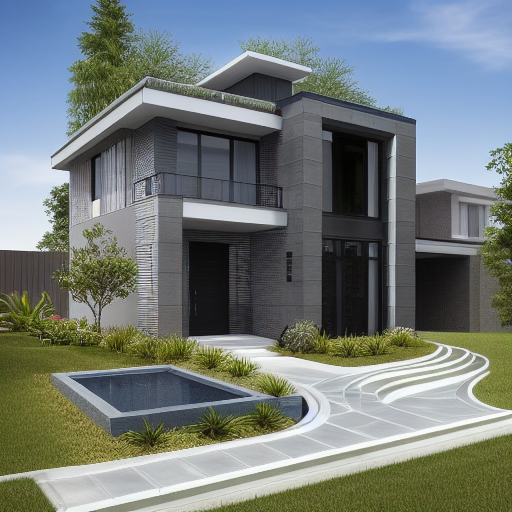

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=5, controlnet_conditioning_scale=1.0


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 5, controlnet_scale: 1.0


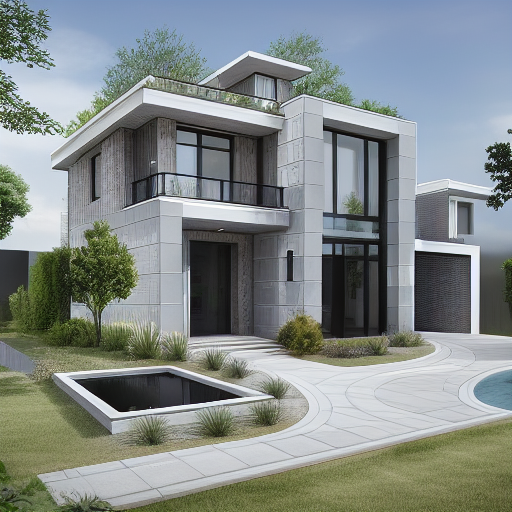

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=7, controlnet_conditioning_scale=0.5


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 7, controlnet_scale: 0.5


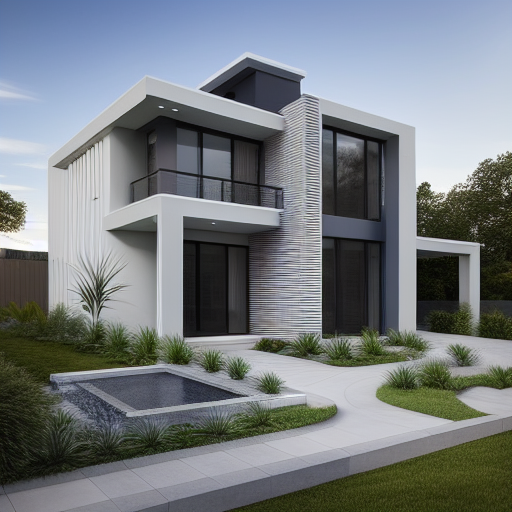

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=7, controlnet_conditioning_scale=0.75


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 7, controlnet_scale: 0.75


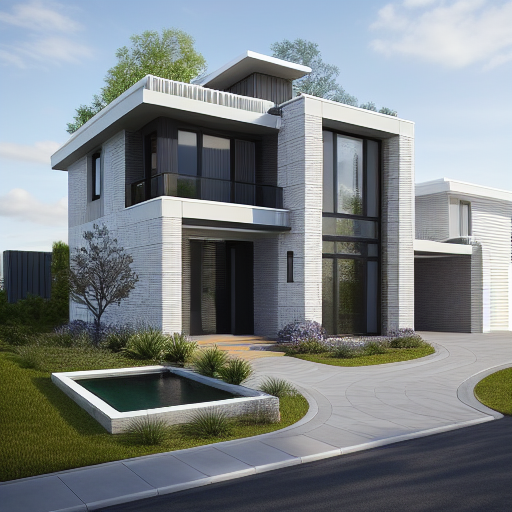

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=7, controlnet_conditioning_scale=1.0


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 7, controlnet_scale: 1.0


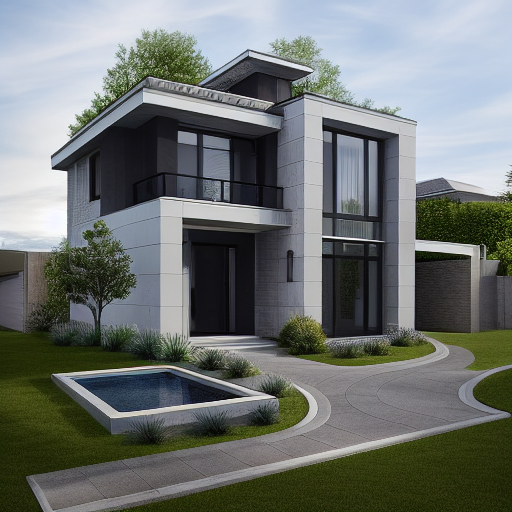

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=9, controlnet_conditioning_scale=0.5


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 9, controlnet_scale: 0.5


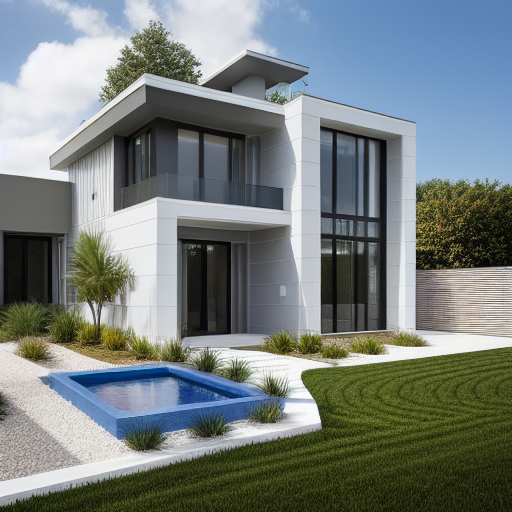

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=9, controlnet_conditioning_scale=0.75


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 9, controlnet_scale: 0.75


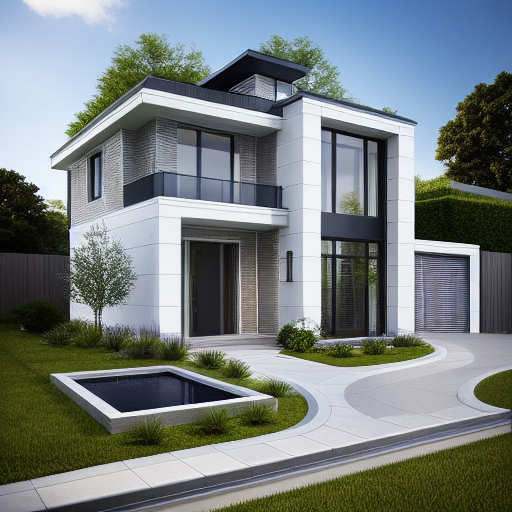

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=9, controlnet_conditioning_scale=1.0


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 9, controlnet_scale: 1.0


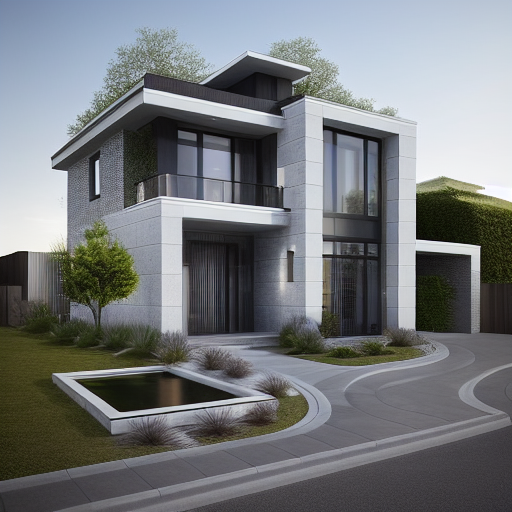

In [13]:
# Tune Guidance and ControlNet Scales
guidance_scales = [5, 7, 9]
controlnet_scales = [0.5, 0.75, 1.0]

for guidance_scale in guidance_scales:
    for controlnet_scale in controlnet_scales:
        print(f"\nGenerating with guidance_scale={guidance_scale}, controlnet_conditioning_scale={controlnet_scale}")

        generated_image = pipe(
            prompt,
            num_inference_steps=20,
            generator=generator,
            image=control_image,
            negative_prompt=negative_prompt,
            guidance_scale=guidance_scale,
            controlnet_conditioning_scale=controlnet_scale
        ).images[0]
        print(f"guidance_scale: {guidance_scale}, controlnet_scale: {controlnet_scale}")
        display(generated_image)

from here, i think the bigger guidance scale and control net scale, the better is the result. i will continue the experiment

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=8, controlnet_conditioning_scale=0.75


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 8, controlnet_scale: 0.75


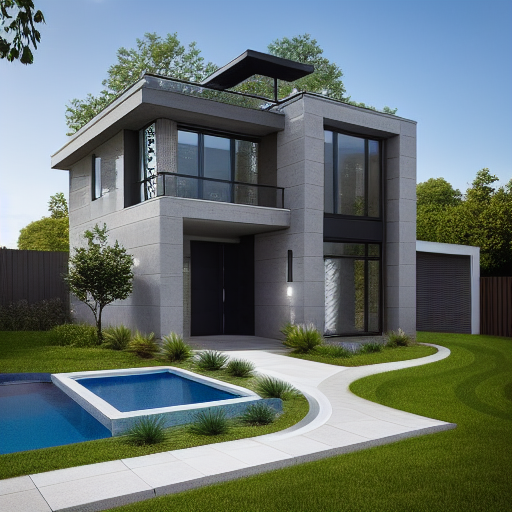

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=8, controlnet_conditioning_scale=1.0


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 8, controlnet_scale: 1.0


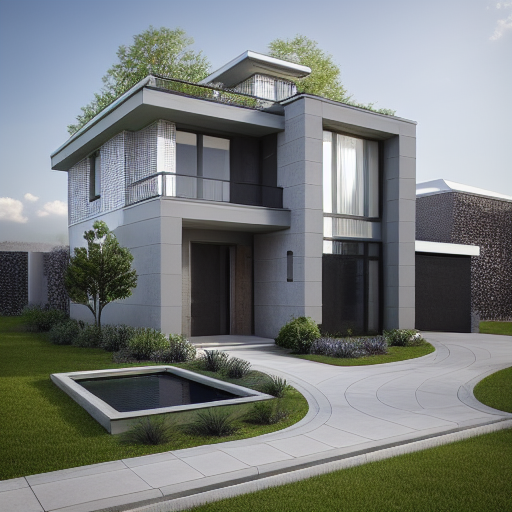

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=8, controlnet_conditioning_scale=1.25


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 8, controlnet_scale: 1.25


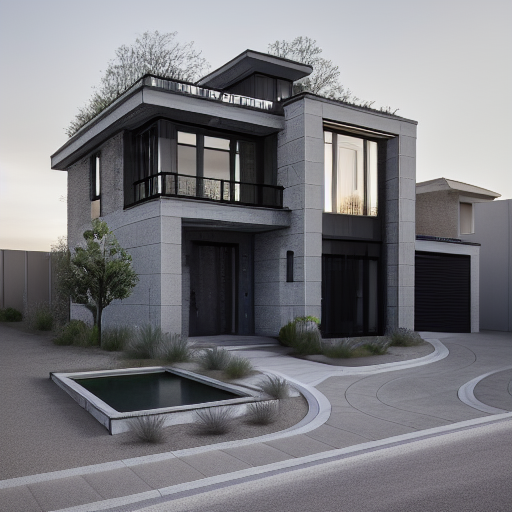

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=8, controlnet_conditioning_scale=1.5


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 8, controlnet_scale: 1.5


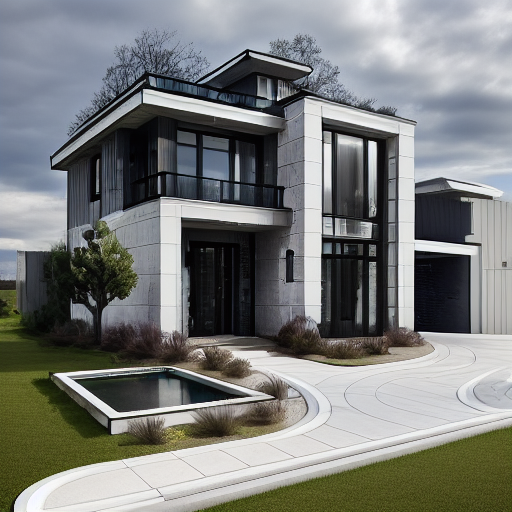

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=10, controlnet_conditioning_scale=0.75


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 10, controlnet_scale: 0.75


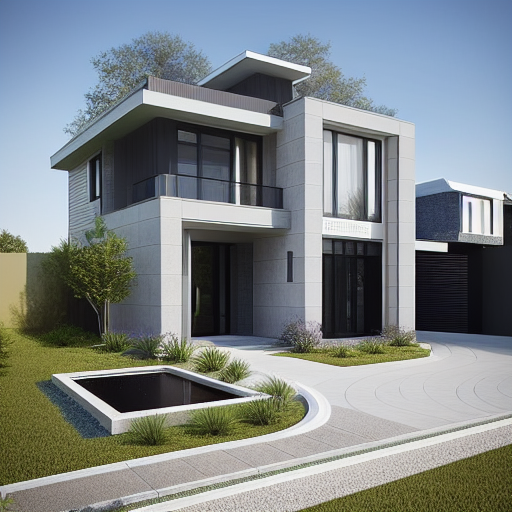

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=10, controlnet_conditioning_scale=1.0


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 10, controlnet_scale: 1.0


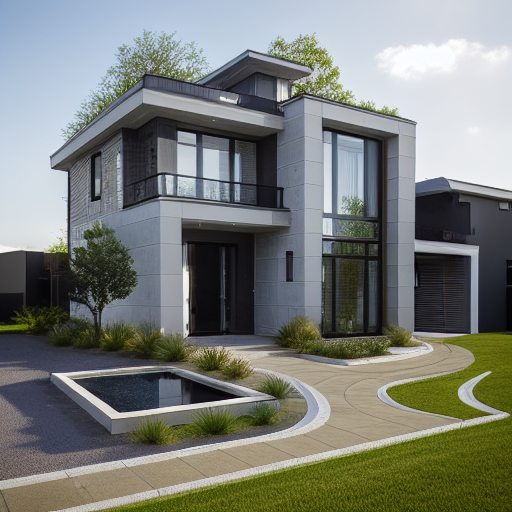

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=10, controlnet_conditioning_scale=1.25


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 10, controlnet_scale: 1.25


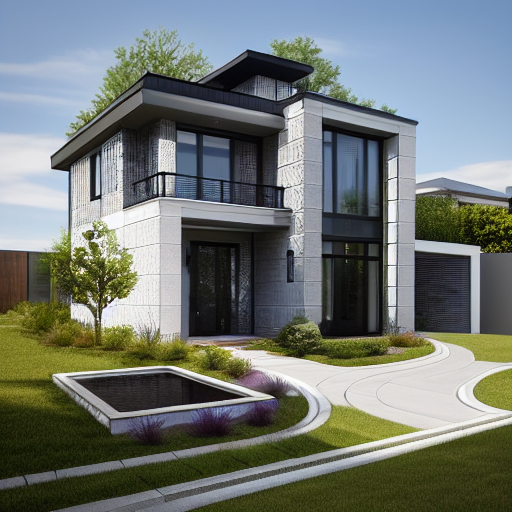

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=10, controlnet_conditioning_scale=1.5


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 10, controlnet_scale: 1.5


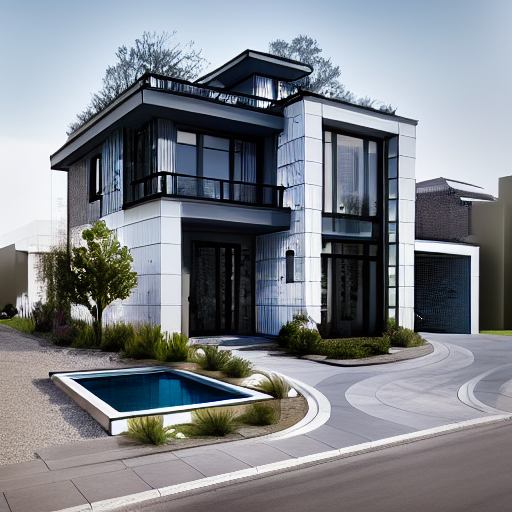

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=12, controlnet_conditioning_scale=0.75


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 12, controlnet_scale: 0.75


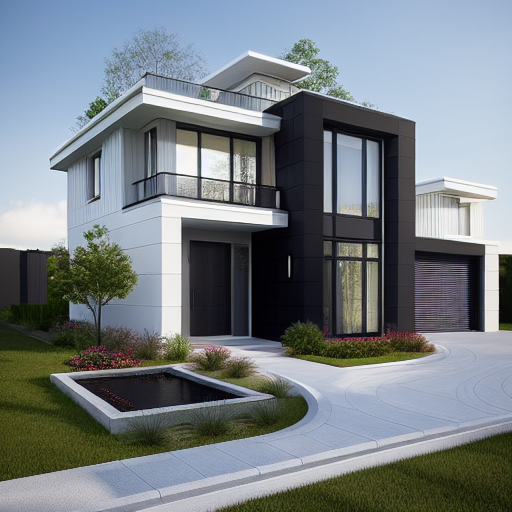

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=12, controlnet_conditioning_scale=1.0


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 12, controlnet_scale: 1.0


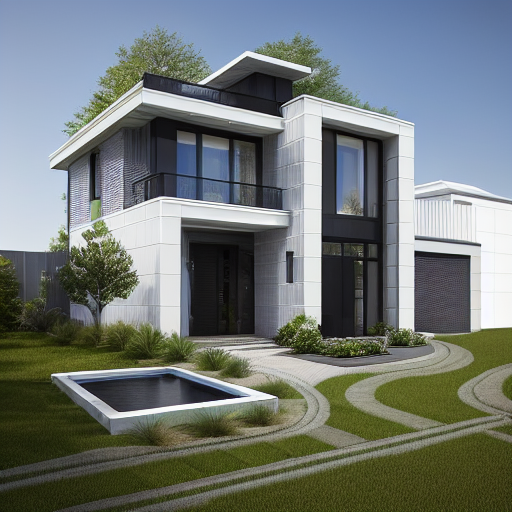

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=12, controlnet_conditioning_scale=1.25


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 12, controlnet_scale: 1.25


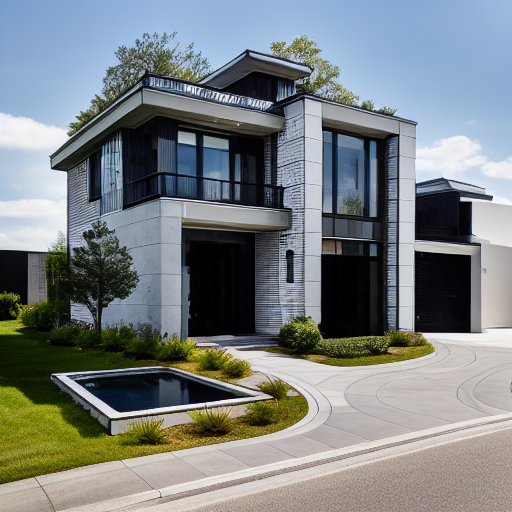

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=12, controlnet_conditioning_scale=1.5


  0%|          | 0/20 [00:00<?, ?it/s]

guidance_scale: 12, controlnet_scale: 1.5


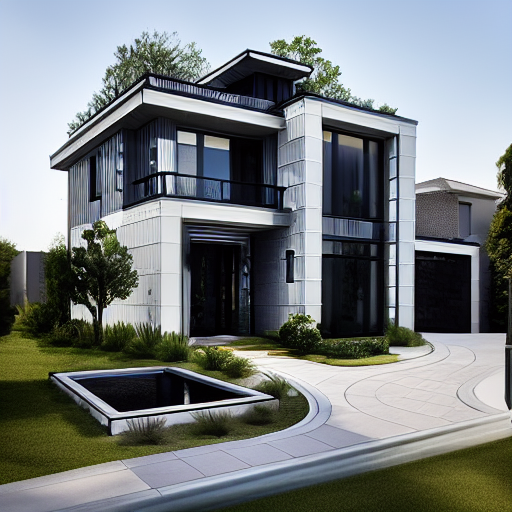

In [15]:
# Tune Guidance and ControlNet Scales
guidance_scales = [8, 10, 12]
controlnet_scales = [0.75, 1.0, 1.25, 1.5]

for guidance_scale in guidance_scales:
    for controlnet_scale in controlnet_scales:
        print(f"\nGenerating with guidance_scale={guidance_scale}, controlnet_conditioning_scale={controlnet_scale}")

        generated_image = pipe(
            prompt,
            num_inference_steps=20,
            generator=generator,
            image=control_image,
            negative_prompt=negative_prompt,
            guidance_scale=guidance_scale,
            controlnet_conditioning_scale=controlnet_scale
        ).images[0]
        print(f"guidance_scale: {guidance_scale}, controlnet_scale: {controlnet_scale}")
        display(generated_image)

after some parameter tuning, i think the sweet spot for guidance scales -s 9-11 and controlnet_scales is 0.8-1.0

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=9, controlnet_conditioning_scale=0.8


  0%|          | 0/50 [00:00<?, ?it/s]

guidance_scale: 9, controlnet_scale: 0.8


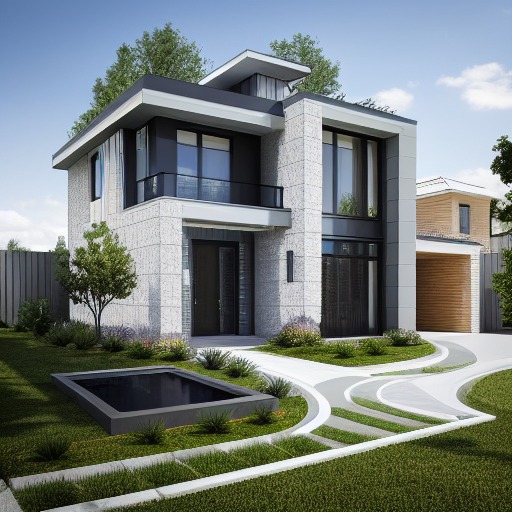

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=9, controlnet_conditioning_scale=0.9


  0%|          | 0/50 [00:00<?, ?it/s]

guidance_scale: 9, controlnet_scale: 0.9


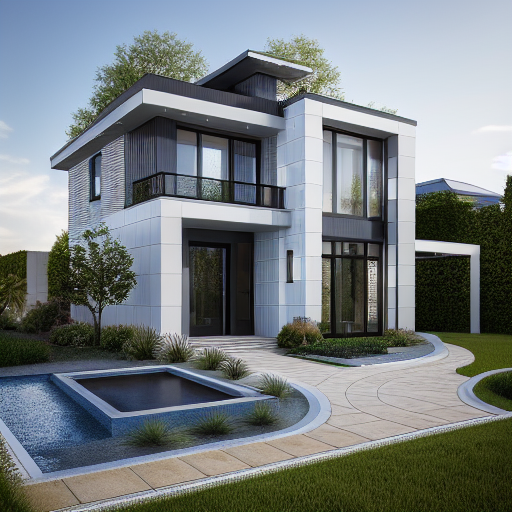

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=9, controlnet_conditioning_scale=1.0


  0%|          | 0/50 [00:00<?, ?it/s]

guidance_scale: 9, controlnet_scale: 1.0


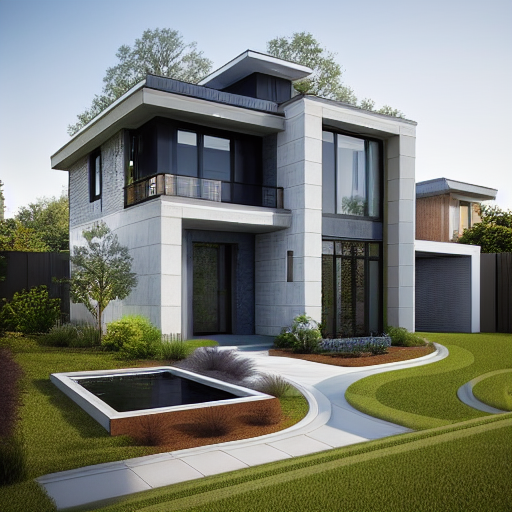

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=10, controlnet_conditioning_scale=0.8


  0%|          | 0/50 [00:00<?, ?it/s]

guidance_scale: 10, controlnet_scale: 0.8


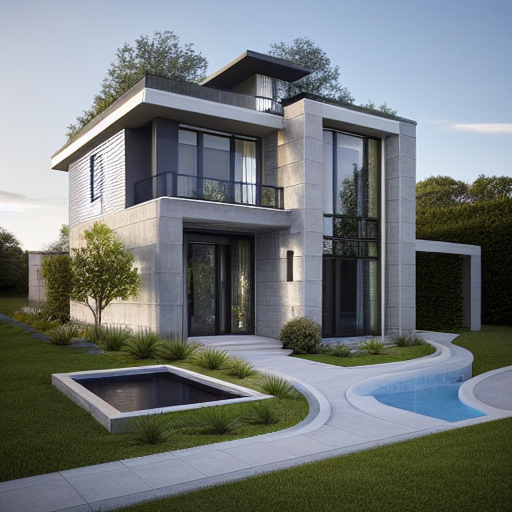

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=10, controlnet_conditioning_scale=0.9


  0%|          | 0/50 [00:00<?, ?it/s]

guidance_scale: 10, controlnet_scale: 0.9


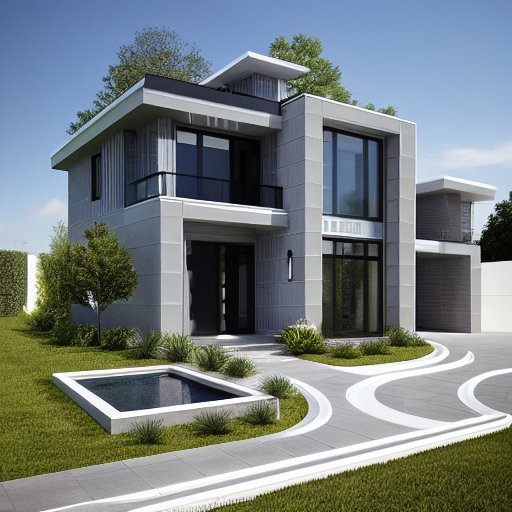

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=10, controlnet_conditioning_scale=1.0


  0%|          | 0/50 [00:00<?, ?it/s]

guidance_scale: 10, controlnet_scale: 1.0


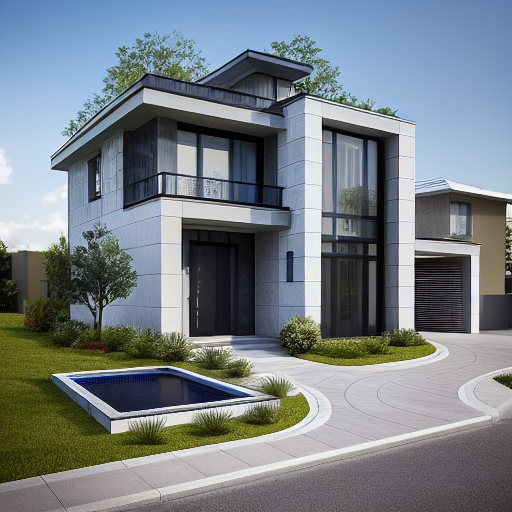

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=11, controlnet_conditioning_scale=0.8


  0%|          | 0/50 [00:00<?, ?it/s]

guidance_scale: 11, controlnet_scale: 0.8


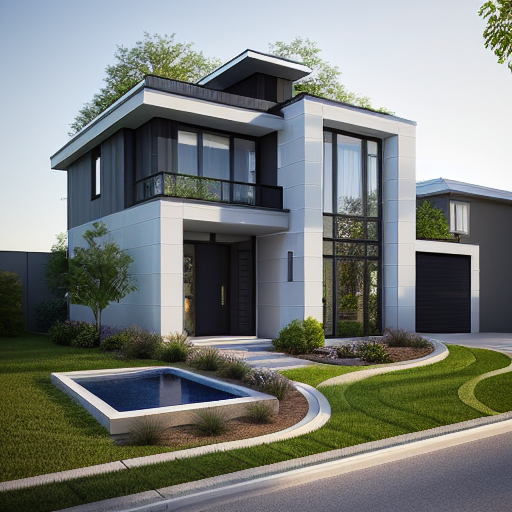

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=11, controlnet_conditioning_scale=0.9


  0%|          | 0/50 [00:00<?, ?it/s]

guidance_scale: 11, controlnet_scale: 0.9


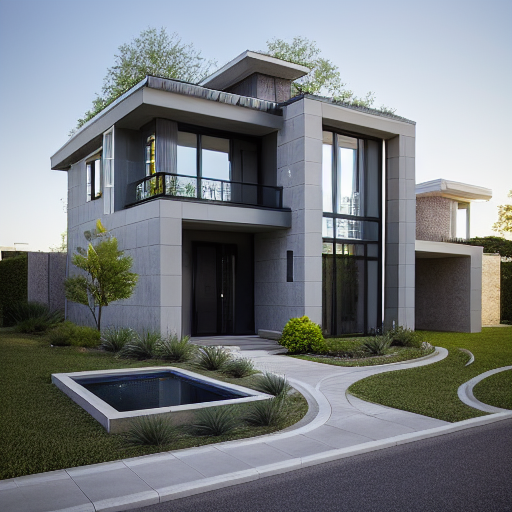

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with


Generating with guidance_scale=11, controlnet_conditioning_scale=1.0


  0%|          | 0/50 [00:00<?, ?it/s]

guidance_scale: 11, controlnet_scale: 1.0


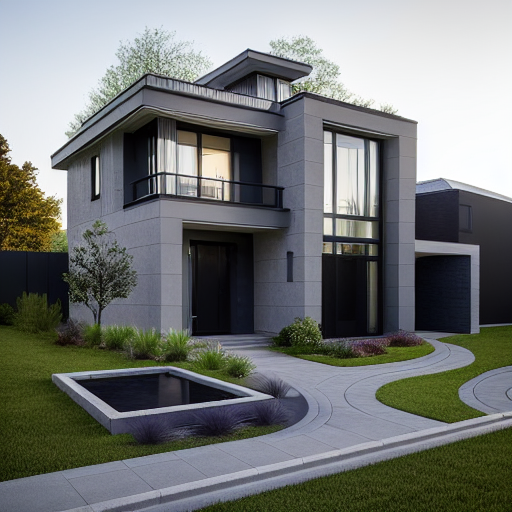

In [16]:
# Tune Guidance and ControlNet Scales
guidance_scales = [9, 10, 11]
controlnet_scales = [0.8, 0.9, 1.0]

for guidance_scale in guidance_scales:
    for controlnet_scale in controlnet_scales:
        print(f"\nGenerating with guidance_scale={guidance_scale}, controlnet_conditioning_scale={controlnet_scale}")

        generated_image = pipe(
            prompt,
            num_inference_steps=50, #improve to 50 for better results
            generator=generator,
            image=control_image,
            negative_prompt=negative_prompt,
            guidance_scale=guidance_scale,
            controlnet_conditioning_scale=controlnet_scale
        ).images[0]
        print(f"guidance_scale: {guidance_scale}, controlnet_scale: {controlnet_scale}")
        display(generated_image)

i score the picture on guidance_scale:10 and controlnet_scale:1.0 better.

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["a green roof , covered in lush sedum , ornamental grasses , and small manicured bushes . window and door details must be exact : the window frames are thin and made of dark charcoal metal . on the right side of the facade , there is a two - story section of floor - to - ceiling glass windows . on the second floor 's front facade , a large horizontal window provides access to a balcony . on the left side of the second floor , there is one smaller , vertical window . the front door is tall , modern , and made of a dark wood with a vertical handle . the second - floor balcony is enclosed by a simple , thin black metal railing . the house is set in a professionally landscaped front yard with modern , sparse plantings . a walkway composed of large , square light - grey concrete pavers curves gently toward the entrance . in the foreground , there is a shallow , square reflecting pool with

  0%|          | 0/30 [00:00<?, ?it/s]

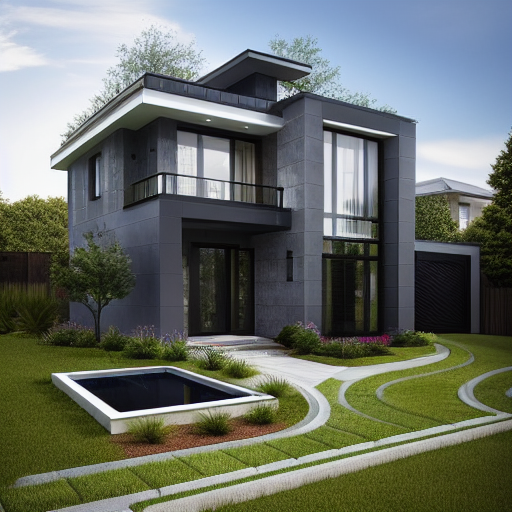

In [20]:
generated_image = pipe(
            prompt,
            num_inference_steps=30,
            generator=generator,
            image=control_image,
            negative_prompt=negative_prompt,
            guidance_scale=10,
            controlnet_conditioning_scale=1.0
).images[0]
display(generated_image)